In [1]:
import polars as pl
import numpy as np
import os
from dotenv import load_dotenv
load_dotenv()



from pathlib import Path
from itertools import combinations
import seaborn as sns
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import ccf

from scipy.signal import correlate, correlation_lags
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import yfinance as yf
import sys
sys.path.append("..")
from src.support.utils import load_config

from datetime import datetime

from src.support.data_transformation import TickerExtender, TechnicalIndicators, FileHandler

In [2]:
def graficar_acf_pacf(lags=36, method="ywmle",data_test=None):
    """
    Grafica las funciones de autocorrelación (ACF) y autocorrelación parcial (PACF).
    
    Parameters:
    -----------
    lags : int
        Número de lags a graficar.
    """
    plt.figure(figsize=(12, 10))
    plot_acf(data_test.drop_nulls(), lags=lags)
    plt.title("Función de Autocorrelación (ACF)")
    plt.grid()
    plt.show()
    
    plt.figure(figsize=(12, 10))
    plot_pacf(data_test.drop_nulls(), lags=lags, method=method)
    plt.title("Función de Autocorrelación Parcial (PACF)")
    plt.grid()
    plt.show()



In [3]:
def subplots_timeseries_lags(timeseries_df: pl.DataFrame, ticker_column: str) -> None:
    # Select the "MSFT" column and ensure it has a date column
    df = timeseries_df

    # Define the lags
    trading_day_lags = {
        '1d': 1,
        '3d': 3,
        '7d': 5,
        '30d': 22,
        '90d': 66,
        '365d': 252
    }

    # Create subplots
    fig = make_subplots(rows=len(trading_day_lags) + 1, cols=1, shared_xaxes=True, vertical_spacing=0.02)

    # Plot the original time datetime
    fig.add_trace(go.Scatter(x=df["datetime"], y=df[ticker_column], name='Original'), row=1, col=1)

    # Plot the lagged time series
    for i, (lag_name, lag_value) in enumerate(trading_day_lags.items(), start=2):

        lagged_series = df.with_columns(
                                        (pl.col(ticker_column).pct_change(lag_value) * 100).alias("lagged")  # Calculate percentage change
                                    ).filter(pl.col("lagged").is_not_null())  # Drop nulls

        fig.add_trace(go.Scatter(x=lagged_series["datetime"], y=lagged_series["lagged"], name=f'Growth rate {lag_name}'), row=i, col=1)


    # Add a date filter slider
    fig.update_layout(
        xaxis=dict(
            rangeselector=dict(
                buttons=list([
                    dict(count=1, label="1m", step="month", stepmode="backward"),
                    dict(count=6, label="6m", step="month", stepmode="backward"),
                    dict(count=1, label="YTD", step="year", stepmode="todate"),
                    dict(count=1, label="1y", step="year", stepmode="backward"),
                    dict(step="all")
                ])
            ),
            rangeslider=dict(visible=False),  # Set rangeslider to False to remove it
            type="date"
        )
    )

    # Update layout for better visualization
    fig.update_layout(height=800, title_text=f"{ticker_column} Time Series with Lags", showlegend=True)

    # Show the figure
    fig.show()

- Análisis de correlaciones
- Cross-correlations? Para encontrar lags
- Mutual informations
- Establecer hipótesis de análisis y principios/conceptos básicos económicos que deben guiarme
- Identificar nuevos símbolos (por ejemplo USD/EUR) y dar conclusiones sobre su impacto

- Análisis entre stocks, stocks con macroindicadores. Luego 2º análisis de generación de indicadores técnicos en transformación.

Anotaciones:
- Existen similitudes en stocks del mismo sector aunque sean de otros continentes.
- Existen diferencias en las distribuciones de los growth rates entre stocks. Tampoco son del todo parecidas las distribuciones entre periodos para todos los stocks.
- Las series temporales tienen más tendencia a más grande el pct_change. Esto hace que tengan menos similitud de distribución.
- VIX es solo para US, cuidado con sus conclusiones

# Import data

In [4]:
dataset = pl.read_parquet("/home/miguel/data_science/algorithmic_trading/data/transformed/dataset.parquet")

In [5]:
filepaths = [file for file in Path("/home/miguel/data_science/algorithmic_trading/data/transformed/OHLCV").rglob('*') if file.is_file()]

first_symbol_name = str(filepaths[0]).split("/")[-1].replace(".csv","")
joined_symbol = pl.read_csv(filepaths[0]).select(pl.col("close","datetime")).rename({"close":first_symbol_name})

for file_path in filepaths[1:2]:
    symbol_name = str(file_path).split("/")[-1].replace(".csv","")
    symbol = pl.read_csv(file_path).select(pl.col("close","datetime")).rename({"close":symbol_name})
    joined_symbol = joined_symbol.join(symbol, on="datetime", how="inner")

joined_symbol = joined_symbol.fill_null(0)

## Plot example time series lags

In [6]:
stocks_tickers_list = load_config("tickers_to_include.yaml")["STOCKS"]

close_prices_df = pl.from_pandas(yf.download(tickers=stocks_tickers_list, 
                                             start="1998-01-01", 
                                             period="max", 
                                             interval="1d")["Close"], include_index=True).rename({"Date":"datetime"})

[*********************100%***********************]  33 of 33 completed


In [7]:
close_prices_df.select(pl.col("datetime"))

datetime
datetime[ns]
1998-01-01 00:00:00
1998-01-02 00:00:00
1998-01-05 00:00:00
1998-01-06 00:00:00
1998-01-07 00:00:00
…
2025-01-20 00:00:00
2025-01-21 00:00:00
2025-01-22 00:00:00


Let's plot the original time series and its lagged version for a few example stocks:

In [8]:
selected_examples = ["SAP","NVDA","NVO"]

for ticker in selected_examples:
    example_df = close_prices_df["datetime",ticker].drop_nulls()
    subplots_timeseries_lags(example_df, ticker_column=ticker)

In the time series for SAP, NVDA and NVO, we see that the shape of the original time series shows a growing trend in all tickers. Growth seems to accelerate from 2020 looking at the original timeseries in the first subplot. However, daily volatility has decreased for these stocks with regards to the beginning of the century, judging from the daily, 3d and 7d growth rates, where we see more pronounced fluctuations in periods around the crisis of 2002 and 2008. 

Yearly growth rates speak about the major cycles these stocks go through. In the case of NVO for example, the downfall dates concur with periods of economical crisis around 2008.


The shape of the distrivution for growth values seem in general quite similar throughout the years, saving for some periods of maximum fluctuations for some stocks like the beginning of the century. The bigger the lag analysed, the more trends are observed and thus the least similar the distributions. Taking a look at the different distributions for the examples above:

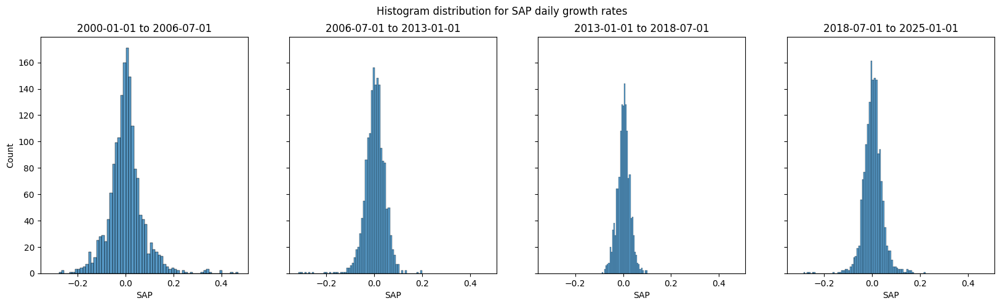

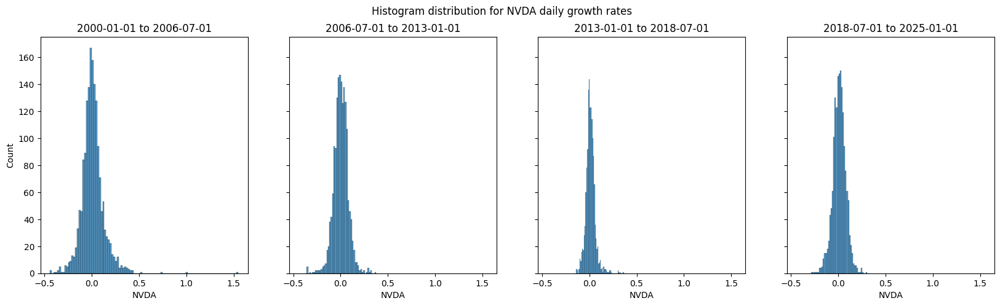

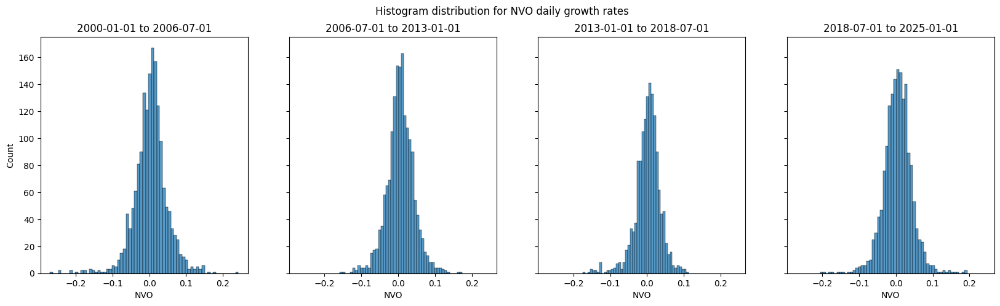

In [9]:
selected_examples = ["SAP","NVDA","NVO"]

for ticker in selected_examples:
    example_df_365d_lag = close_prices_df["datetime",ticker].with_columns(pl.col(ticker).pct_change(5)).drop_nulls()
    interval_edges = ["2000-01-01","2006-07-01","2013-01-01","2018-07-01","2025-01-01"]

    fig, axes = plt.subplots(1,4,figsize=(20,5), sharex=True,sharey=True)
    fig.suptitle(f"Histogram distribution for {ticker} daily growth rates")
    axes = axes.flat 
    for lapse, ax in enumerate(axes):
        start, end = [datetime.strptime(interval_edges[lapse], "%Y-%m-%d"), datetime.strptime(interval_edges[lapse+1], "%Y-%m-%d")]
        fig
        sns.histplot(data=example_df_365d_lag.filter(pl.col("datetime") > start, pl.col("datetime") < end),
                     x=ticker, ax=ax)
        ax.set_title(f"{interval_edges[lapse]} to {interval_edges[lapse+1]}")
    plt.show()

Looking at the growth rates, the differences seen between price distributions are cancelled, showing growth rates centered around 0 and tipically spread between -0.2 and 0.2.
This makes forecasting through classic methods more approachable as distributions among periods are similar. In these examples, the periods of maximum growth value spread is between 2000 and 2006, which seems to concur with world economic crisis taken place around that time.

Seeing these patterns, it is interesting to see how major macroeconomic indicators like the DGS and euroyield, and major indices like SNP500 in the US and EURONEXT in EU have evolved during these periods. Also looking at industry specific indices could be interesting.

Macroeconomic indicators by country
- DGS (US) and EuroYield. When bonds do better than stocks, it is a sign of fear in the stock market, just like with GOLD. A better indicator is the safe haven demand. TLT, GLD
- Stock price strength
- VIX (US) + 50 day SMA. High values mean high fear
- CPI

Indices by country
- SNP500
- DAX (Germany)
- EURONEXT


Indices by sector
- FNGU..

Global indicators
- WTI
- Brent Oil
- Gold
- BTC
- How do I tell cycles?

If GOLD and Bonds, or other commodities do well, it is a sign of fear.


In [67]:
DGS_1 = pl.read_csv("../data/extracted/macro/DGS1.csv").rename({"DATE":"datetime"}).with_columns(pl.col("datetime").str.to_datetime())
VIX = pl.read_csv("../data/extracted/macro/^VIX.csv").rename({"date":"datetime"}).select(pl.col("datetime").str.to_datetime(), "close")

macro_joined = DGS_1.join(VIX, on="datetime", how="inner").filter(pl.col("datetime") > datetime(2000, 1, 1)).fill_null(strategy="forward")
macro_joined

datetime,DGS1_prev1_d,close
datetime[μs],f64,f64
2000-01-04 00:00:00,6.09,27.01
2000-01-05 00:00:00,6.0,26.41
2000-01-06 00:00:00,6.05,25.73
2000-01-07 00:00:00,6.03,21.719999
2000-01-11 00:00:00,6.07,22.5
…,…,…
2025-01-17 00:00:00,4.18,15.97
2025-01-21 00:00:00,4.18,15.06
2025-01-22 00:00:00,4.21,15.1


In [73]:
fig = make_subplots(rows=1, cols=1, shared_xaxes=True, vertical_spacing=0.02, specs=[[{"secondary_y": True}]])

fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["close"], name='VIX Volatility'), row=1, col=1, secondary_y=False)

fig.add_trace(go.Scatter(x=macro_joined["datetime"], y=macro_joined["DGS1_prev1_d"], name='Euro Yield - 1 Year'), row=1, col=1, secondary_y=True)



# Add a date filter slider
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(count=6, label="6m", step="month", stepmode="backward"),
                dict(count=1, label="YTD", step="year", stepmode="todate"),
                dict(count=1, label="1y", step="year", stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(visible=False),  # Set rangeslider to False to remove it
        type="date"
    )
)

# Update layout for better visualization
fig.update_layout(height=400, title_text=f"close Time Series with Lags", showlegend=True)

# Show the figure
fig.show()

<Axes: xlabel='DGS1_prev1_d', ylabel='close'>

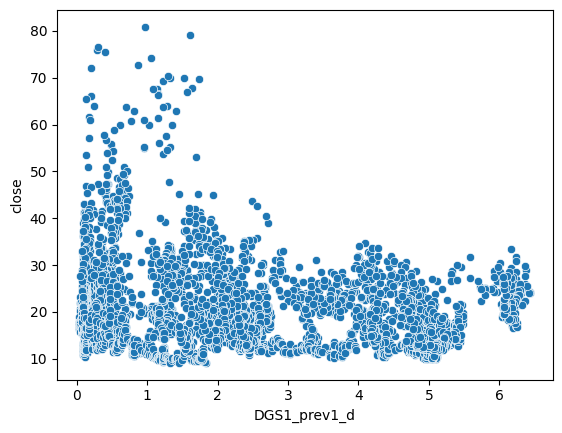

In [83]:
sns.scatterplot(data=macro_joined.select(pl.exclude("datetime")),
                x="DGS1_prev1_d",
                y="close")

In [80]:
import polars as pl
import numpy as np
from sklearn.metrics import mutual_info_score
from itertools import combinations
from joblib import Parallel, delayed

def calculate_mutual_info(dataset: pl.DataFrame, n_jobs: int = -1) -> pl.DataFrame:
    """
    Computes the mutual information matrix for a Polars DataFrame in parallel.

    Args:
        dataset (pl.DataFrame): Input dataset with categorical or numerical data.
        n_jobs (int): Number of parallel jobs (-1 uses all available CPUs).

    Returns:
        pl.DataFrame: Symmetric matrix of mutual information values.
    """
    # Convert to numpy for efficient processing
    dataset_numpy = dataset.to_numpy()
    num_cols = dataset.shape[1]
    column_names = dataset.columns

    # Initialize a symmetric matrix with zeros
    mutual_info_matrix = np.zeros((num_cols, num_cols))

    # Function to calculate mutual information for a pair of columns
    def compute_mi_r(pair):
        i, j = pair
        mi = mutual_info_score(dataset_numpy[:, i], dataset_numpy[:, j])
        r = np.sqrt(1 - np.exp(-2 * mi))
        return i, j, r

    # Generate combinations of column indices
    column_pairs = combinations(range(num_cols), 2)

    # Compute mutual information in parallel
    results = Parallel(n_jobs=n_jobs, backend='loky')(
        delayed(compute_mi_r)(pair) for pair in column_pairs
    )

    # Fill in the mutual information matrix
    for i, j, r in results:
        mutual_info_matrix[i, j] = r
        mutual_info_matrix[j, i] = r

    # Create a Polars DataFrame from the symmetric matrix
    mutual_info_df = pl.DataFrame(mutual_info_matrix, schema=column_names)


    return mutual_info_df



mi_matrix = calculate_mutual_info(macro_joined.select(pl.exclude("datetime")))
mi_matrix


/home/miguel/data_science/algorithmic_trading/.venv/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and continuous values for target
  warnings.warn(msg, UserWarning)


DGS1_prev1_d,close
f64,f64
0.0,0.999964
0.999964,0.0


In [105]:
import polars as pl
import numpy as np
from sklearn.metrics import mutual_info_score
from itertools import combinations
from joblib import Parallel, delayed
from scipy.stats import entropy
from typing import Tuple


import polars as pl
import numpy as np
from sklearn.metrics import mutual_info_score
from itertools import combinations
from joblib import Parallel, delayed

from sklearn.feature_selection import mutual_info_regression
import numpy as np
from itertools import combinations
from joblib import Parallel, delayed

def compute_normalized_mi_with_regression(dataset: pl.DataFrame, n_jobs: int = -1) -> (pl.DataFrame, pl.DataFrame):
    """
    Computes the normalized mutual information matrix and joint entropy matrix for continuous variables using mutual_info_regression.

    Args:
        dataset (pl.DataFrame): Input dataset with continuous data.
        n_jobs (int): Number of parallel jobs (-1 uses all available CPUs).

    Returns:
        tuple: Two Polars DataFrames, one for normalized mutual information and one for joint entropy values.
    """
    # Convert to numpy for efficient processing
    dataset_numpy = dataset.to_numpy()
    num_cols = dataset.shape[1]
    column_names = dataset.columns

    # Initialize symmetric matrices with zeros
    normalized_mi_matrix = np.zeros((num_cols, num_cols))
    joint_entropy_matrix = np.zeros((num_cols, num_cols))

    # Function to calculate normalized mutual information and joint entropy for a pair of columns
    def compute_normalized_mi_and_joint_entropy(pair):
        i, j = pair
        col_i = dataset_numpy[:, i]
        col_j = dataset_numpy[:, j]

        # Calculate mutual information using mutual_info_regression for continuous data
        mi = mutual_info_regression(col_i.reshape(-1, 1), col_j, n_neighbors=20)[0]  # We reshape to 2D as expected by sklearn

        # Calculate joint entropy
        joint_hist, _, _ = np.histogram2d(col_i, col_j, bins=20, density=True)  # Joint histogram
        joint_probs = joint_hist / joint_hist.sum()  # Normalize to get probabilities

        # Ensure joint probabilities sum to 1
        assert np.isclose(joint_probs.sum(), 1), f"Joint probability sum is {joint_probs.sum()}"

        # Remove zero probabilities to avoid log(0)
        joint_probs = joint_probs[joint_probs > 0]
        joint_entropy = -np.sum(joint_probs * np.log(joint_probs))  # Joint entropy

        # Normalize mutual information by joint entropy
        normalized_mi = mi / joint_entropy if joint_entropy > 0 else 0

        return i, j, normalized_mi, joint_entropy, np.sqrt(1 - np.exp(-2 * mi))

    # Generate combinations of column indices
    column_pairs = combinations(range(num_cols), 2)

    # Compute mutual information and joint entropy in parallel
    results = Parallel(n_jobs=n_jobs, backend='loky')(
        delayed(compute_normalized_mi_and_joint_entropy)(pair) for pair in column_pairs
    )

    # Fill in the matrices
    for i, j, normalized_mi, joint_entropy, r in results:
        normalized_mi_matrix[i, j] = normalized_mi
        normalized_mi_matrix[j, i] = normalized_mi
        joint_entropy_matrix[i, j] = joint_entropy
        joint_entropy_matrix[j, i] = joint_entropy

    # Create Polars DataFrames from the symmetric matrices
    normalized_mi_df = pl.DataFrame(normalized_mi_matrix, schema=column_names)
    joint_entropy_df = pl.DataFrame(joint_entropy_matrix, schema=column_names)

    return normalized_mi_df, joint_entropy_df



# Example usage
mi_matrix, joint_entropy_matrix = compute_normalized_mi_with_regression(
    dataset=macro_joined.select(pl.exclude("datetime"))
)
mi_matrix, joint_entropy_matrix


(shape: (2, 2)
 ┌──────────────┬──────────┐
 │ DGS1_prev1_d ┆ close    │
 │ ---          ┆ ---      │
 │ f64          ┆ f64      │
 ╞══════════════╪══════════╡
 │ 0.0          ┆ 0.069075 │
 │ 0.069075     ┆ 0.0      │
 └──────────────┴──────────┘,
 shape: (2, 2)
 ┌──────────────┬──────────┐
 │ DGS1_prev1_d ┆ close    │
 │ ---          ┆ ---      │
 │ f64          ┆ f64      │
 ╞══════════════╪══════════╡
 │ 0.0          ┆ 4.363328 │
 │ 4.363328     ┆ 0.0      │
 └──────────────┴──────────┘)

In [90]:
macro_joined.select(pl.exclude("datetime")).to_pandas().corr("spearman")

,DGS1_prev1_d,close
DGS1_prev1_d,1.000000,-0.098046
close,-0.098046,1.000000


In [ ]:
CPI

In [27]:

DGS_1

DATE,DGS1_prev1_d
str,f64
"""1962-01-03T00:00:00.000000000""",3.22
"""1962-01-04T00:00:00.000000000""",3.24
"""1962-01-05T00:00:00.000000000""",3.24
"""1962-01-06T00:00:00.000000000""",3.26
"""1962-01-09T00:00:00.000000000""",3.31
…,…
"""2025-01-18T00:00:00.000000000""",4.21
"""2025-01-21T00:00:00.000000000""",null
"""2025-01-22T00:00:00.000000000""",4.21


In [28]:
VIX = pl.read_csv("../data/extracted/macro/^VIX.csv")
VIX

date,close,high,low,open,volume,symbol,currency,country,region
str,f64,f64,f64,f64,i64,str,str,str,str
"""1990-01-02T00:00:00.000000000""",17.24,17.24,17.24,17.24,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""
"""1990-01-03T00:00:00.000000000""",18.190001,18.190001,18.190001,18.190001,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""
"""1990-01-04T00:00:00.000000000""",19.219999,19.219999,19.219999,19.219999,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""
"""1990-01-05T00:00:00.000000000""",20.110001,20.110001,20.110001,20.110001,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""
"""1990-01-08T00:00:00.000000000""",20.26,20.26,20.26,20.26,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""
…,…,…,…,…,…,…,…,…,…
"""2025-01-17T00:00:00.000000000""",15.97,16.23,15.53,16.190001,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""
"""2025-01-21T00:00:00.000000000""",15.06,16.290001,14.93,16.290001,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""
"""2025-01-22T00:00:00.000000000""",15.1,15.29,14.59,14.89,0,"""^VIX""","""USD""","""United States""","""US_AMERICA"""


In [12]:
ticker_extender = TickerExtender()
euro_yld = pl.read_csv("../data/extracted/macro/eurostat_euro_yield.csv")
euro_yld = ticker_extender.transform_euro_yield_df(euro_yld)
euro_yld


datetime,eur_yld_DGS_Y1_prev_2d,eur_yld_DGS_Y5_prev_2d,eur_yld_DGS_Y10_prev_2d
datetime[μs],f32,f32,f32
2004-09-08 00:00:00,2.29884,3.45722,4.20922
2004-09-09 00:00:00,2.32889,3.47952,4.20963
2004-09-10 00:00:00,2.34667,3.50789,4.22842
2004-09-13 00:00:00,2.30899,3.43063,4.16187
2004-09-14 00:00:00,2.27157,3.37473,4.12098
…,…,…,…
2025-01-16 00:00:00,2.37854,2.39536,2.71869
2025-01-17 00:00:00,2.33828,2.30341,2.63028
2025-01-20 00:00:00,2.3636,2.31758,2.65778


In [488]:
import pandas_datareader as pdr

umcsent = pdr.DataReader("UMCSENT", "fred", start="2000-01-01")

<Axes: xlabel='DATE'>

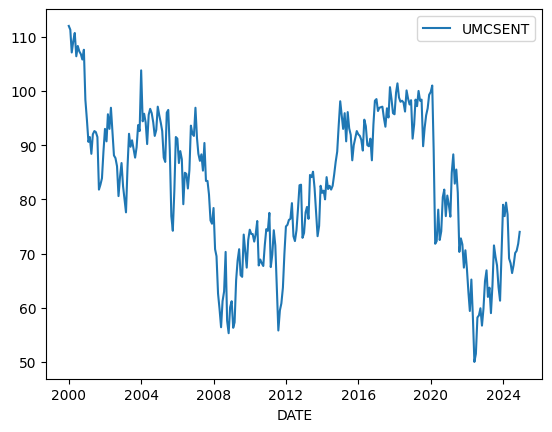

In [490]:
sns.lineplot(umcsent)

## Principles of economic factors

# Analysis between stocks

- Macro indicators with SNP500 and other indices
- Add currencies

## Correlation analysis 

<Axes: >

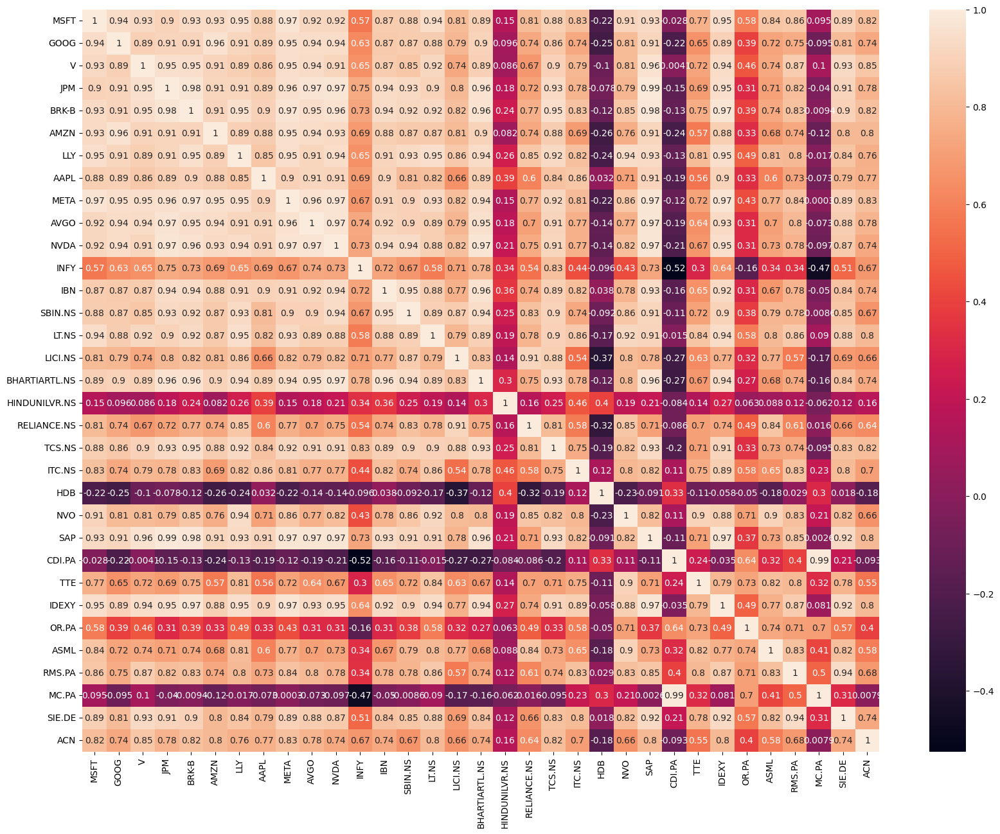

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,15))
sns.heatmap(joined_symbol.select(pl.exclude("datetime")).to_pandas().corr(), annot=True)

<Axes: >

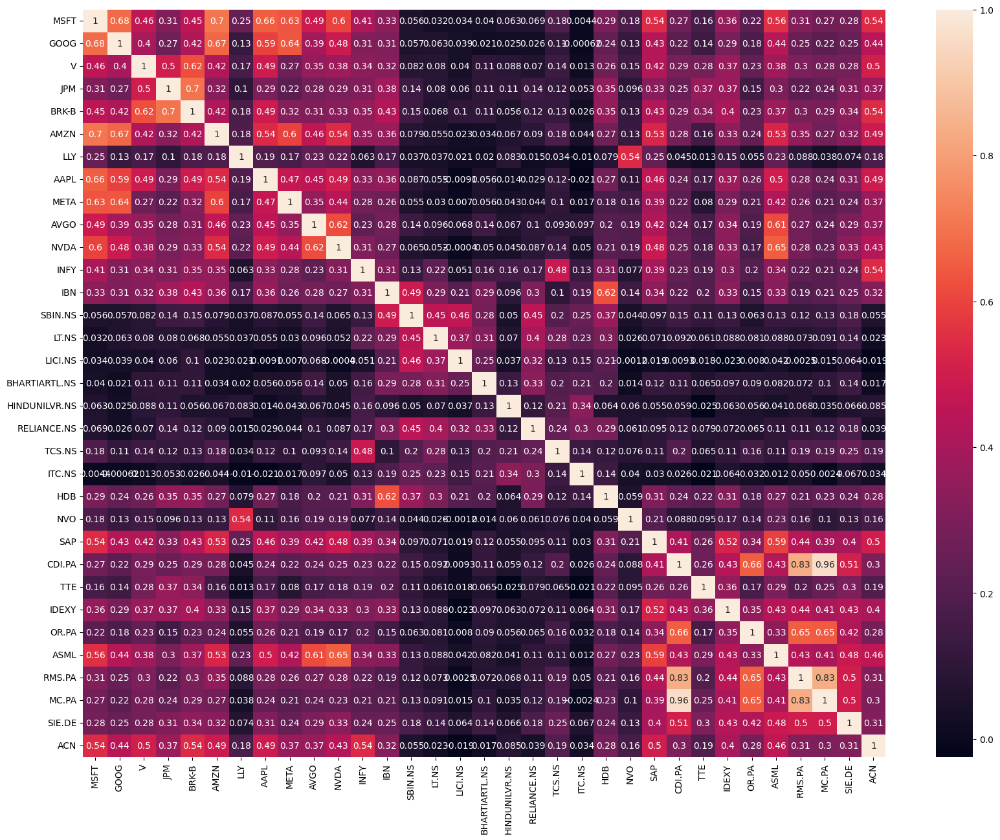

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,15))
sns.heatmap(joined_symbol_lagged.drop_nulls().to_pandas().corr(), annot=True)

Heatmap of:
- Original ["close"]
- Growth over 1d
- Growth over 7d
- Growth over 30d (?)

Pairplot:
- Original
- Growth over 1d

Add mutual information heatmap if it applies, to contrast with pairplot

<Axes: xlabel='MSFT', ylabel='GOOG'>

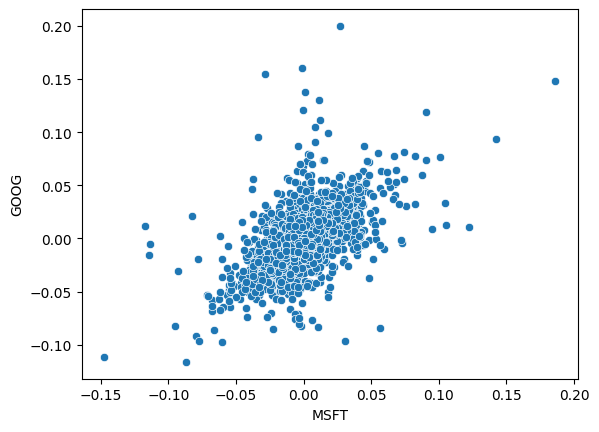

In [351]:
sns.scatterplot(data=joined_symbol_lagged,
                x="MSFT",
                y= "GOOG")

## Cross-correlation

In [374]:
def multi_xcorr_lag(data):
    results = {}
    for (col1, col2) in combinations(data.columns, 2):
        corr = correlate(data[col1], data[col2], mode='full')
        lags = correlation_lags(len(data[col1]), len(data[col2]), mode='full')
        optimal_lag = lags[np.argmax(corr)]
        results[f"{col1} vs {col2}"] = optimal_lag
    return results

## Plot time series comparison

Plot time series diff

<Axes: >

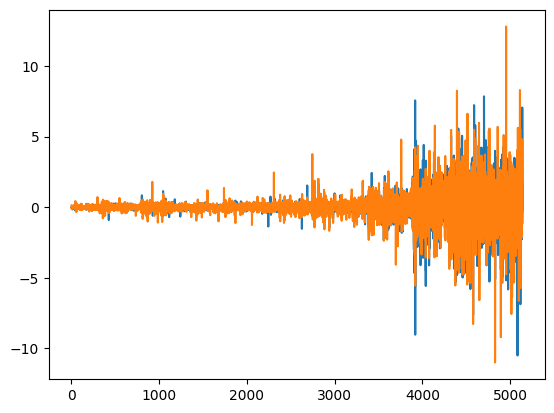

In [301]:
joined_symbol_diffed_norm = joined_symbol_diffed.with_columns(
                ((pl.exclude("datetime") - pl.exclude("datetime").mean()) / pl.exclude("datetime").std()
                 ))
sns.lineplot(joined_symbol_diffed_norm["MSFT"])
sns.lineplot(joined_symbol_diffed_norm["GOOG"])

Autocorrelación

<Figure size 1200x1000 with 0 Axes>

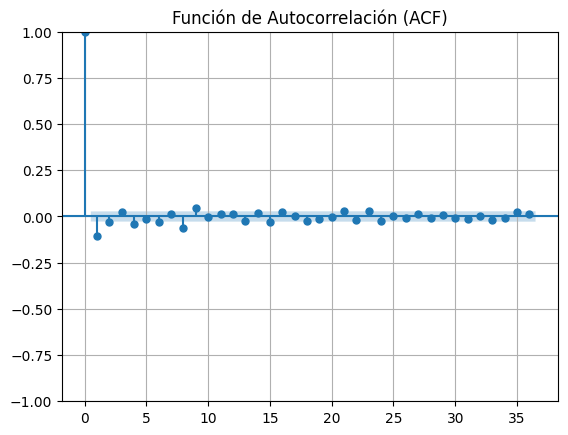

<Figure size 1200x1000 with 0 Axes>

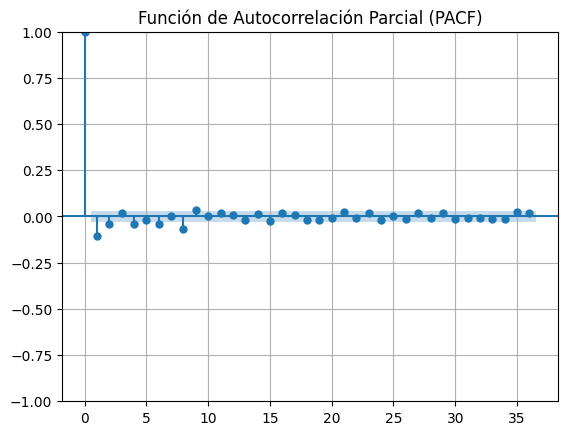

In [244]:

graficar_acf_pacf(data_test=joined_symbol_lagged["MSFT"])

### Cross-correlation

Usar ccf de statsmodels mejor, con el cálculo de la significación y la simetría generados:

[*********************100%***********************]  2 of 2 completed


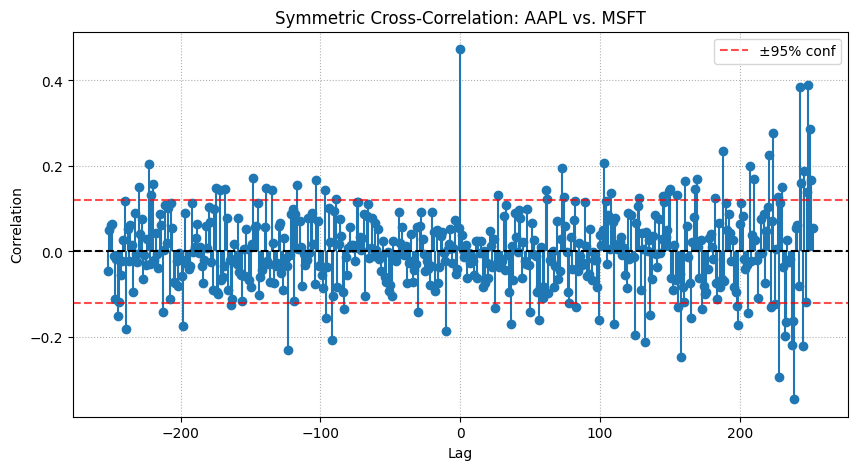

In [390]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from statsmodels.tsa.stattools import ccf

def plot_ccf_symmetric_statsmodels(x, y, max_lag=30, x_name="x", y_name="y", figsize=(10,5)):
    """
    Plot a symmetrical cross-correlation function (CCF) for two time series x and y
    using statsmodels.tsa.stattools.ccf, covering negative and positive integer lags.

    Parameters
    ----------
    x, y : pandas Series
        Time series (preferably stationary, e.g. returns) to be cross-correlated.
        Should share a common time index or at least significant overlap.
    max_lag : int
        Maximum positive/negative lag to plot.
    x_name, y_name : str
        Names for the labels in the plot.
    figsize : tuple
        Size of the figure.

    Notes
    -----
    - statsmodels.ccf() only returns CCF for lags >= 0.
      To get negative lags, we swap x and y and combine the results.
    - This approach is an approximation if your series are autocorrelated.
      For real statistical testing, you might need more advanced methods.
    """
    # 1) Align on the common index to avoid misalignment
    x = x.dropna()
    y = y.dropna()
    common_idx = x.index.intersection(y.index)
    x = x.loc[common_idx]
    y = y.loc[common_idx]

    # 2) Convert to numpy arrays (statsmodels ccf works on arrays)
    #    Optionally do differencing or log returns if the data isn't stationary
    #    Also recommended to standardize/normalize if you want 'similar scales'
    x_arr = x.values
    y_arr = y.values

    # 3) statsmodels' ccf => correlation for lags = 0..(len(x)-1)
    #    ccf(x, y): how y "follows" x
    #    ccf(y, x): how x "follows" y
    ccf_xy = ccf(x_arr, y_arr)  # This includes lag=0.. up to max possible
    ccf_yx = ccf(y_arr, x_arr)

    # 4) Truncate to max_lag + 1 terms from each (0..max_lag)
    #    ccf_xy[0] = lag 0, ccf_xy[1] = lag 1, ...
    #    so ccf_xy[:max_lag+1] means lags 0..max_lag
    ccf_xy_pos_lags = ccf_xy[: max_lag + 1]  # Lags: 0..+max_lag
    ccf_yx_pos_lags = ccf_yx[: max_lag + 1]  # Lags: 0..+max_lag

    # 5) To form negative lags, we can interpret ccf(y,x) at lag k
    #    as ccf(x,y) at lag -k. So ccf_yx_pos_lags[1..max_lag] => negative lags
    #    We'll reverse them to go from -max_lag..-1.
    neg_lags = np.arange(-max_lag, 0)
    pos_lags = np.arange(0, max_lag + 1)

    # slice [1:] to skip the zero-lag, then reverse
    ccf_neg = ccf_yx_pos_lags[1:][::-1]  # Lags: (max_lag..1) reversed => -1..-max_lag
    ccf_pos = ccf_xy_pos_lags            # Lags: 0..+max_lag

    # Combine them for symmetrical range
    ccf_full = np.concatenate([ccf_neg, ccf_pos])
    lags_full = np.concatenate([neg_lags, pos_lags])

    # 6) Rough 95% confidence intervals => ±2/sqrt(N)
    #    (N is effectively the sample size. This is a rule of thumb for white noise.)
    N = len(x_arr)
    conf = 2.0 / np.sqrt(N)

    # 7) Plot
    plt.figure(figsize=figsize)
    plt.stem(lags_full, ccf_full, basefmt=" ")
    plt.axhline(0, color='black', linestyle='--')
    plt.axhline(conf, color='red', linestyle='--', alpha=0.7, label='±95% conf')
    plt.axhline(-conf, color='red', linestyle='--', alpha=0.7)
    plt.title(f"Symmetric Cross-Correlation: {x_name} vs. {y_name}")
    plt.xlabel('Lag')
    plt.ylabel('Correlation')
    plt.legend()
    plt.grid(True, ls=':')
    plt.show()

# Example usage:
from yfinance import download
df = download(["MSFT", "AAPL"], start="2023-12-01", end="2025-01-01")["Close"]
# Suppose we plot symmetrical CCF on daily returns
ret_aapl = df["MSFT"].pct_change().dropna()
ret_msft = df["AAPL"].pct_change().dropna()
plot_ccf_symmetric_statsmodels(ret_aapl, ret_msft, max_lag=252, x_name="AAPL", y_name="MSFT")